# What's this guitar...

A quick first notebook to distinguish between 11 guitar models from Gibson and Fender... All data downloaded and cleaned using [fastclass](https://github.com/cwerner/fastclass). The full dataset consists of 27 classes, but cleaning them is quite time consuming... Will rerun when all are inspected.

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
# transform filenames (run only once)
#import glob
#import os
#import shutil
#folders = glob.glob('data/guitars/*')
#for f in folders:
#    c = os.path.basename(f).lower()
#    ims = glob.glob(f+'/*.jpg')
#    for im in ims:
#        fnew = 'data/guitars.labeled/' + c + '_' + os.path.basename(im)
#        shutil.copyfile(im, fnew)

In [3]:
from fastai import *
from fastai.vision import *

In [4]:
bs = 32

## Looking at the data

In [5]:
import pathlib
path = pathlib.Path.cwd()/'data/guitars.labeled'; path

PosixPath('/home/jupyter/excercises/data/guitars.labeled')

In [6]:
path.ls()[:5]

[PosixPath('/home/jupyter/excercises/data/guitars.labeled/fender_telecaster_000796.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_les_paul_000802.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_es_000049.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_explorer_000561.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_flying_v_000243.jpg')]

In [7]:
np.random.seed(2)
pat = r'/([^/]+)_\d+.jpg$'

In [8]:
fnames = get_image_files(path)
display(len(fnames))
fnames[-10:]

8500

[PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_sg_000737.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_explorer_000840.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/fender_jaguar_000034.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_firebird_000047.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_flying_v_000318.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_flying_v_000032.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/fender_jaguar_001009.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_explorer_000183.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_es_000106.jpg'),
 PosixPath('/home/jupyter/excercises/data/guitars.labeled/gibson_sg_000545.jpg')]

In [9]:
path_img = Path('/home/jupyter/excercises/data/images')

In [10]:
data = ImageDataBunch.from_name_re(path, fnames, pat, ds_tfms=get_transforms(), size=224, bs=bs)
data.normalize(imagenet_stats)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


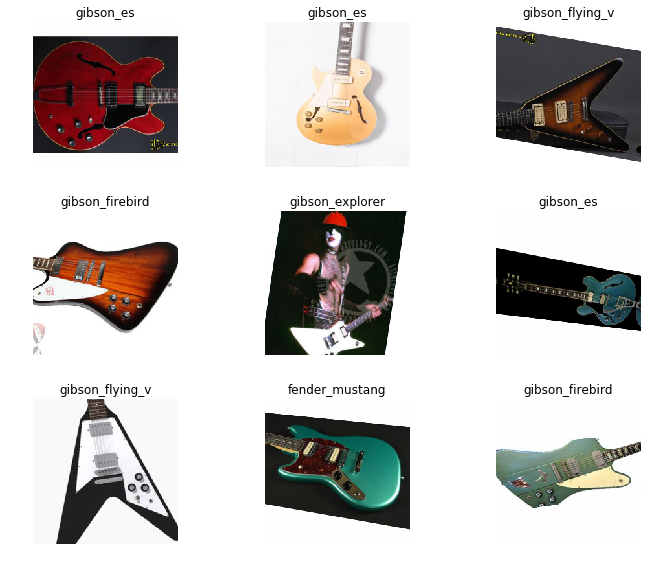

In [11]:
data.show_batch(rows=3, figsize=(10,8))

In [12]:
print(data.classes)
len(data.classes),data.c

['fender_telecaster', 'gibson_les_paul', 'gibson_es', 'gibson_explorer', 'gibson_flying_v', 'fender_mustang', 'fender_stratocaster', 'gibson_sg', 'fender_jaguar', 'gibson_firebird', 'fender_jazzmaster']


(11, 11)

## Training: resnet34

Now we will start training our model. We will use a [convolutional neural network](http://cs231n.github.io/convolutional-networks/) backbone and a fully connected head with a single hidden layer as a classifier. Don't know what these things mean? Not to worry, we will dive deeper in the coming lessons. For the moment you need to know that we are building a model which will take images as input and will output the predicted probability for each of the categories (in this case, it will have 37 outputs).

We will train for 4 epochs (4 cycles through all our data).

In [30]:
learn = create_cnn(data, models.resnet34, metrics=error_rate)

In [31]:
learn.fit_one_cycle(4)

Total time: 04:43
epoch  train_loss  valid_loss  error_rate
1      0.791232    0.462169    0.160046    (01:10)
2      0.536857    0.245423    0.079447    (01:11)
3      0.321255    0.179009    0.061600    (01:11)
4      0.288252    0.160660    0.055843    (01:10)



In [32]:
learn.save('stage-1')

## Results

Let's see what results we have got. 

We will first see which were the categories that the model most confused with one another. We will try to see if what the model predicted was reasonable or not. In this case the mistakes look reasonable (none of the mistakes seems obviously naive). This is an indicator that our classifier is working correctly. 

Furthermore, when we plot the confusion matrix, we can see that the distribution is heavily skewed: the model makes the same mistakes over and over again but it rarely confuses other categories. This suggests that it just finds it difficult to distinguish some specific categories between each other; this is normal behaviour.

In [33]:
interp = ClassificationInterpretation.from_learner(learn)

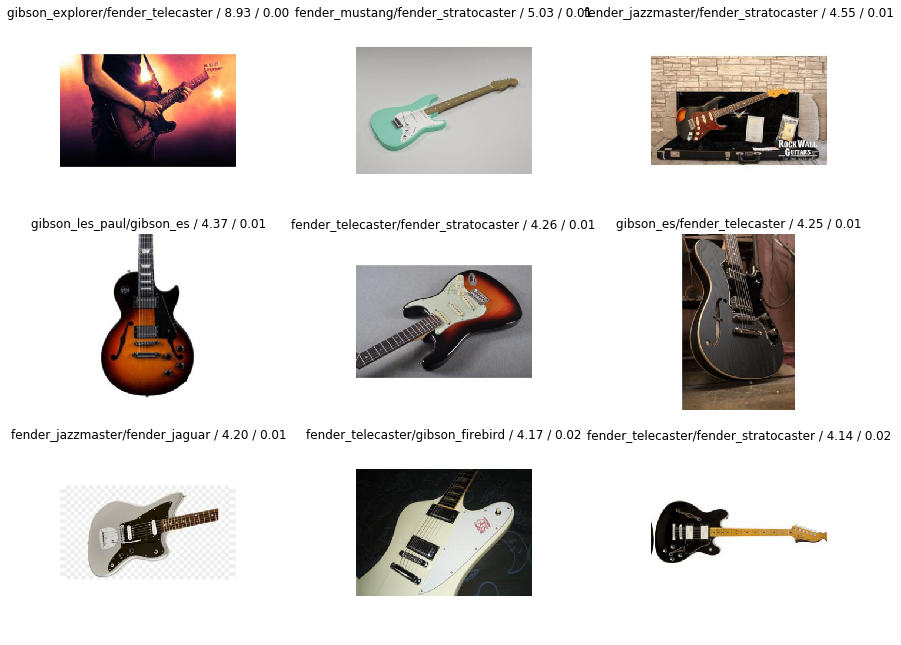

In [34]:
interp.plot_top_losses(9, figsize=(15,11))

In [35]:
doc(interp.plot_top_losses)

plot_top_losses [source] plot_top_losses ( k , largest = True , figsize = (12, 12) ) 
 
 Show images in top_losses along with their prediction, actual, loss, and probability of actual class. 
 Show in docs

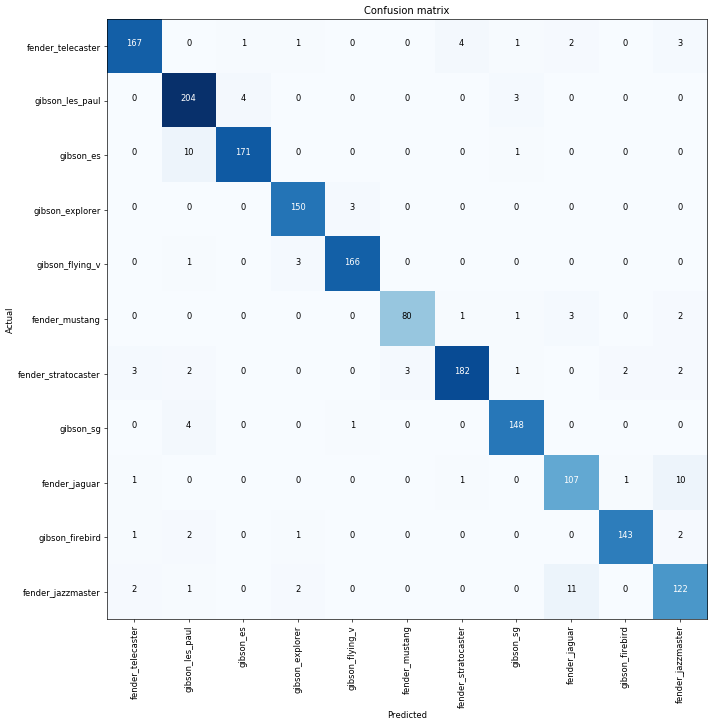

In [36]:
interp.plot_confusion_matrix(figsize=(12,12), dpi=60)

In [37]:
interp.most_confused(min_val=2)

[('fender_jazzmaster', 'fender_jaguar', 11),
 ('gibson_es', 'gibson_les_paul', 10),
 ('fender_jaguar', 'fender_jazzmaster', 10),
 ('fender_telecaster', 'fender_stratocaster', 4),
 ('gibson_les_paul', 'gibson_es', 4),
 ('gibson_sg', 'gibson_les_paul', 4),
 ('fender_telecaster', 'fender_jazzmaster', 3),
 ('gibson_les_paul', 'gibson_sg', 3),
 ('gibson_explorer', 'gibson_flying_v', 3),
 ('gibson_flying_v', 'gibson_explorer', 3),
 ('fender_mustang', 'fender_jaguar', 3),
 ('fender_stratocaster', 'fender_telecaster', 3),
 ('fender_stratocaster', 'fender_mustang', 3)]

## Unfreezing, fine-tuning, and learning rates

Since our model is working as we expect it to, we will *unfreeze* our model and train some more.

In [38]:
learn.unfreeze()

In [39]:
learn.fit_one_cycle(1)

Total time: 01:36
epoch  train_loss  valid_loss  error_rate
1      0.497388    0.191424    0.058722    (01:36)



In [40]:
learn.load('stage-1')

In [41]:
learn.lr_find()

LR Finder complete, type {learner_name}.recorder.plot() to see the graph.


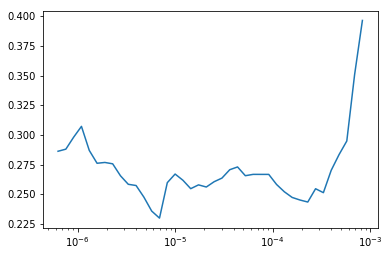

In [42]:
learn.recorder.plot()

In [43]:
learn.unfreeze()
learn.fit_one_cycle(2, max_lr=slice(1e-6,1e-4))

Total time: 03:11
epoch  train_loss  valid_loss  error_rate
1      0.280469    0.121257    0.036845    (01:35)
2      0.209272    0.114073    0.034542    (01:35)



That's a pretty accurate model!

## Training: resnet50

Now we will train in the same way as before but with one caveat: instead of using resnet34 as our backbone we will use resnet50 (resnet34 is a 34 layer residual network while resnet50 has 50 layers. Later in the course you can learn the details in the [resnet paper](https://arxiv.org/pdf/1512.03385.pdf)).

Basically, resnet50 usually performs better because it is a deeper network with more parameters. Let's see if we can achieve a higher performance here. To help it along, let's us larger images too, since that way the network can see more detail. We reduce the batch size a bit since otherwise this larger network might eat up our GPU memory.

In [44]:
data = ImageDataBunch.from_name_re(path, fnames, pat, ds_tfms=get_transforms(), size=299, bs=bs//2)
data.normalize(imagenet_stats)

In [45]:
learn = create_cnn(data, models.resnet50, metrics=error_rate)

In [46]:
learn.fit_one_cycle(8, max_lr=slice(1e-3))

Total time: 17:15
epoch  train_loss  valid_loss  error_rate
1      0.880641    0.582968    0.200837    (02:09)
2      0.529023    0.330172    0.111775    (02:09)
3      0.367968    0.208527    0.071130    (02:09)
4      0.287636    0.161927    0.053198    (02:09)
5      0.206306    0.151824    0.050807    (02:09)
6      0.164480    0.123706    0.035864    (02:09)
7      0.118516    0.115152    0.038852    (02:09)
8      0.114631    0.115837    0.035864    (02:09)



In [47]:
learn.save('stage-1-50')

Let's see if full fine-tuning helps:

In [51]:
learn.unfreeze()
learn.fit_one_cycle(2, max_lr=slice(1e-6,1e-4))

Total time: 05:51
epoch  train_loss  valid_loss  error_rate
1      0.120090    0.116794    0.036461    (02:55)
2      0.097953    0.109604    0.031680    (02:55)



In [52]:
learn.save('stage-2-50')

In [53]:
interp = ClassificationInterpretation.from_learner(learn)

In [54]:
interp.most_confused(min_val=2)

[('fender_jaguar', 'fender_jazzmaster', 8),
 ('gibson_es', 'gibson_les_paul', 5),
 ('gibson_les_paul', 'gibson_es', 3),
 ('gibson_explorer', 'gibson_flying_v', 3),
 ('gibson_flying_v', 'gibson_explorer', 3),
 ('fender_stratocaster', 'fender_telecaster', 3),
 ('fender_jazzmaster', 'fender_jaguar', 3)]

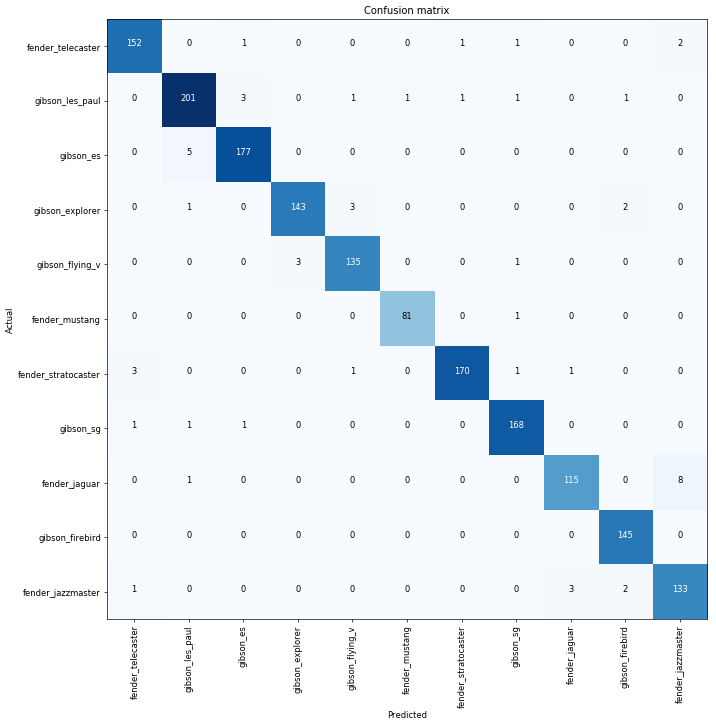

In [55]:
interp.plot_confusion_matrix(figsize=(12,12), dpi=60)

# Predict a single uploaded image

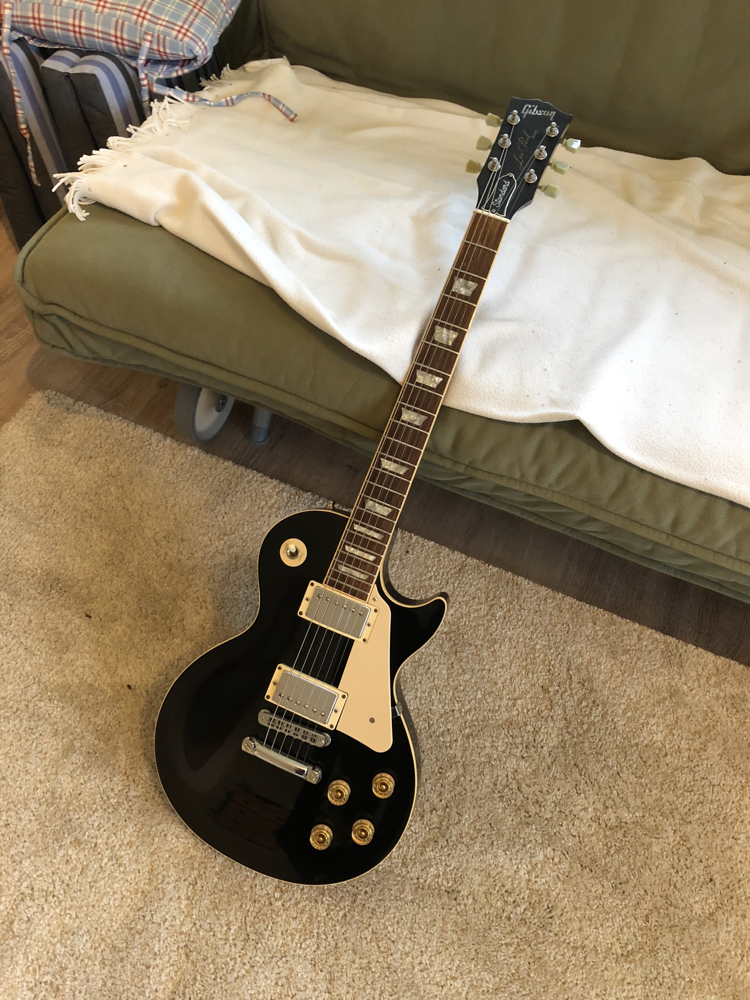

In [61]:
filename = 'data/guit1.jpg'
img = open_image(filename)
img

In [62]:
losses = img.predict(learn)
learn.data.classes[losses.argmax()]


'gibson_les_paul'